<a href="https://colab.research.google.com/github/AnuragChaudhari9/AnuragChaudhari9/blob/main/F1_Monaco23_Q3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import fastf1
from fastf1 import plotting
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import numpy as np

In [ ]:
year = 2023
grand_prix = 'Monaco'
session_type = 'Qualifying'

In [ ]:
session = fastf1.get_session(year, grand_prix, session_type)
session.load()

req         WARNING 	DEFAULT CACHE ENABLED! (24.0 KB) /root/.cache/fastf1
core           INFO 	Loading data for Monaco Grand Prix - Qualifying [v3.4.4]
INFO:fastf1.fastf1.core:Loading data for Monaco Grand Prix - Qualifying [v3.4.4]
req            INFO 	No cached data found for session_info. Loading data...
INFO:fastf1.fastf1.req:No cached data found for session_info. Loading data...
_api           INFO 	Fetching session info data...
INFO:fastf1.api:Fetching session info data...
req            INFO 	Data has been written to cache!
INFO:fastf1.fastf1.req:Data has been written to cache!
req            INFO 	No cached data found for driver_info. Loading data...
INFO:fastf1.fastf1.req:No cached data found for driver_info. Loading data...
_api           INFO 	Fetching driver list...
INFO:fastf1.api:Fetching driver list...
req            INFO 	Data has been written to cache!
INFO:fastf1.fastf1.req:Data has been written to cache!
req            INFO 	No cached data found for session_status_da

In [ ]:
driver_1 = 'VER'
driver_2 = 'ALO'

In [ ]:
laps_driver1 = session.laps.pick_drivers(driver_1)
fastest_lap_driver1 = laps_driver1.pick_fastest()
telemetry_driver1 = fastest_lap_driver1.get_telemetry()

In [ ]:
laps_driver2 = session.laps.pick_drivers(driver_2)
fastest_lap_driver2 = laps_driver2.pick_fastest()
telemetry_driver2 = fastest_lap_driver2.get_telemetry()

In [ ]:
corner_distances = [
    (200, "T1: Sainte Devote"),
    (420, "T2: Beau Rivage"),
    (780, "T3: Massenet"),
    (880, "T4: Casino"),
    (1100, "T5: Mirabeau"),
    (1225, "T6: Hairpin"),
    (1300, "T7: Mirabeau Bas"),
    (1400, "T8: Portier"),
    (1650, "T9: Tunnel Exit"),
    (2075, "T10: Nouvelle Chicane"),
    (2350, "T11: Tabac"),
    (2670, "T12: Swimming Pool"),
    (2860, "T13: Rascasse"),
    (2950, "T14: Anthony Noghes"),
]

In [ ]:
corner_labels = [f"T{i+1}" for i in range(len(corner_distances))]
corner_names = [name for _, name in corner_distances]

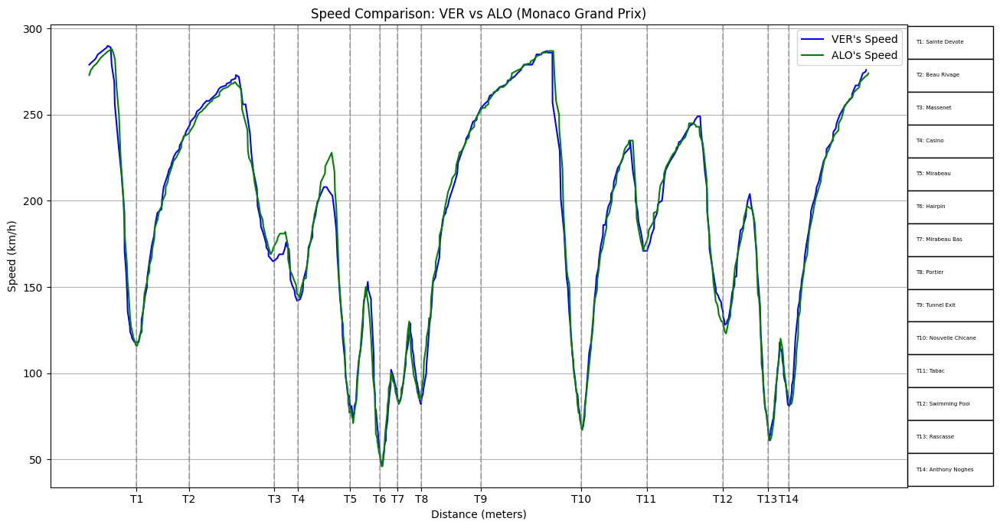

In [ ]:
fig, ax = plt.subplots(figsize=(14, 7))
ax.plot(telemetry_driver1['Distance'], telemetry_driver1['Speed'], label=f"{driver_1}'s Speed", color='blue')
ax.plot(telemetry_driver2['Distance'], telemetry_driver2['Speed'], label=f"{driver_2}'s Speed", color='green')

corner_positions = [distance for distance, _ in corner_distances]
ax.set_xticks(corner_positions)
ax.set_xticklabels(corner_labels)

for distance in corner_positions:
    ax.axvline(distance, color='gray', linestyle='--', alpha=0.5)

ax.set_title(f"Speed Comparison: {driver_1} vs {driver_2} ({session.event['EventName']})")
ax.set_xlabel("Distance (meters)")
ax.set_ylabel("Speed (km/h)")
ax.legend()
ax.grid()

table_data = [[name] for name in corner_names]
table = plt.table(cellText=table_data, loc='right', cellLoc='left', colLoc='center')
table.scale(0.1, 2.3)

plt.tight_layout()
plt.subplots_adjust(right=0.85)
plt.show()

<ipython-input-107-6e1150f6ce97>:5: FutureWarning: Telemetry.interpolate with object dtype is deprecated and will raise in a future version. Call obj.infer_objects(copy=False) before interpolating instead.
  telemetry_driver1 = telemetry_driver1.interpolate(method='linear', axis=0)
<ipython-input-107-6e1150f6ce97>:6: FutureWarning: Telemetry.interpolate with object dtype is deprecated and will raise in a future version. Call obj.infer_objects(copy=False) before interpolating instead.
  telemetry_driver2 = telemetry_driver2.interpolate(method='linear', axis=0)


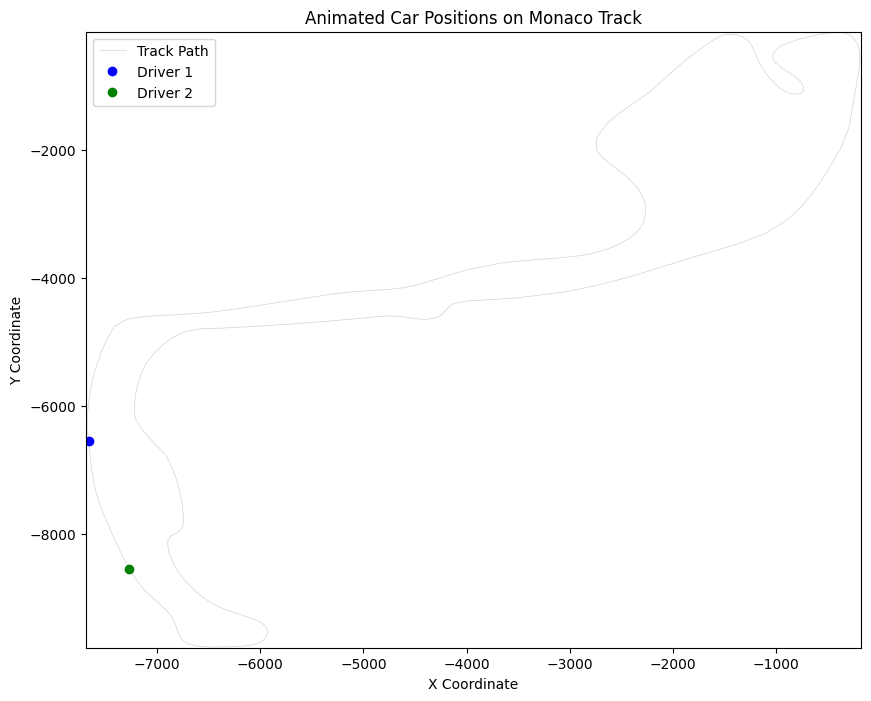

In [ ]:
telemetry_driver1 = telemetry_driver1.infer_objects(copy=False)
telemetry_driver2 = telemetry_driver2.infer_objects(copy=False)

# Linear interpolation for missing telemetry points
telemetry_driver1 = telemetry_driver1.interpolate(method='linear', axis=0)
telemetry_driver2 = telemetry_driver2.interpolate(method='linear', axis=0)

# Set up the figure and axis for plotting
fig, ax = plt.subplots(figsize=(10, 8))

# Plot the Monaco track (You can use your own Monaco track coordinates if available)
ax.plot(telemetry_driver1['X'], telemetry_driver1['Y'], color='lightgrey', linewidth=0.5, label='Track Path')

# Initialize the dots for the two drivers
dot1, = ax.plot([], [], 'o', color='blue', label='Driver 1')  # Blue dot for Driver 1
dot2, = ax.plot([], [], 'o', color='green', label='Driver 2')  # Green dot for Driver 2

# Set the axis limits based on the telemetry data
ax.set_xlim(min(telemetry_driver1['X'].min(), telemetry_driver2['X'].min()) - 10,
            max(telemetry_driver1['X'].max(), telemetry_driver2['X'].max()) + 10)
ax.set_ylim(min(telemetry_driver1['Y'].min(), telemetry_driver2['Y'].min()) - 10,
            max(telemetry_driver1['Y'].max(), telemetry_driver2['Y'].max()) + 10)

ax.set_title("Animated Car Positions on Monaco Track")
ax.set_xlabel("X Coordinate")
ax.set_ylabel("Y Coordinate")
ax.legend()

# Animation update function
def update(frame):
    # Ensure the frame is a valid integer and check the lengths of the data
    if frame < len(telemetry_driver1) and frame < len(telemetry_driver2):
        x1 = [telemetry_driver1['X'].iloc[frame]]  # Wrap x1 in a list
        y1 = [telemetry_driver1['Y'].iloc[frame]]  # Wrap y1 in a list
        x2 = [telemetry_driver2['X'].iloc[frame]]  # Wrap x2 in a list
        y2 = [telemetry_driver2['Y'].iloc[frame]]  # Wrap y2 in a list

        # Check if they are valid numerical values
        if np.isfinite(x1[0]) and np.isfinite(y1[0]):  # Check the first element
            dot1.set_data(x1, y1)

        if np.isfinite(x2[0]) and np.isfinite(y2[0]):  # Check the first element
            dot2.set_data(x2, y2)

    return dot1, dot2

# Create the animation
ani = FuncAnimation(fig, update, frames=max(len(telemetry_driver1), len(telemetry_driver2)),
                    interval=50, blit=True)

# Display animation in Colab using HTML5 (for inline display in the notebook)
HTML(ani.to_jshtml())